<a href="https://colab.research.google.com/github/arps1214p/safeai/blob/main/adv_patch_whitebox.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install addict

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.backends import cudnn

import torchvision
from torchvision import transforms
from torchvision import datasets, models, transforms
import torch.nn.functional as F

import PIL
from PIL import Image

import math
import random
import seaborn as sn
import pandas as pd
import numpy as np
from pathlib import Path
from skimage import io
import pickle
import matplotlib.pyplot as plt
import time
import os
import copy
from tqdm import tqdm_notebook

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

import argparse, yaml
from addict import Dict

import kagglehub

import logging
import sys

print("PyTorch Version: ", torch.__version__)
print("Torchvision Version: ", torchvision.__version__)
print("Pillow Version: ", PIL.__version__)

train_on_gpu = torch.cuda.is_available()

if not train_on_gpu:
    print('CUDA is not available.  Training on CPU ...')
else:
    print('CUDA is available!  Training on GPU ...')

path = "/content/checkpoint.pt"

PyTorch Version:  2.6.0+cu124
Torchvision Version:  0.21.0+cu124
Pillow Version:  11.2.1
CUDA is available!  Training on GPU ...


In [ ]:
# 모델 구조 불러오기
model = models.resnet18(weights=None, num_classes=42)

In [ ]:
# Generalized-Mean Pooling (GeM)
# avgpool -> p-norm pooling

class GeM(nn.Module):
    def __init__(self, p=3.0, eps=1e-6):
        super().__init__()
        self.p = nn.Parameter(torch.ones(1)*p)
        self.eps = eps
    def forward(self, x):
        return F.adaptive_avg_pool2d(x.clamp(min=self.eps).pow(self.p), (1,1)).pow(1./self.p)

# 교체
model.avgpool = GeM()

In [ ]:
state_dict = torch.load(
    path,
    map_location=torch.device('cpu'),
    weights_only=True
)
model.load_state_dict(state_dict)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = model.to(device)

In [ ]:
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

### Dataload

In [ ]:
# Download latest version
path = kagglehub.dataset_download("alexattia/the-simpsons-characters-dataset")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/the-simpsons-characters-dataset


In [ ]:
train_dir = Path('/kaggle/input/the-simpsons-characters-dataset/simpsons_dataset/simpsons_dataset')
test_dir = Path('/kaggle/input/the-simpsons-characters-dataset/kaggle_simpson_testset/kaggle_simpson_testset')

In [ ]:
class TrainValTestSplit():

  def __init__(self, train_dir, test_dir):

    self.train_dir = train_dir
    self.test_dir = test_dir
    # 하위 디렉토리를 순회하며 이미지의 경로를 리스트로 저장
    self.train_val_files_path = sorted(list(self.train_dir.rglob('*.jpg')))
    self.test_path = sorted(list(self.test_dir.rglob('*.jpg')))
    self.train_val_labels = [path.parent.name for path in self.train_val_files_path]

  def get_path(self):

    train_files_path, val_files_path = train_test_split(self.train_val_files_path, test_size = 0.3, \
                                          stratify=self.train_val_labels, random_state = 42)

    train_val_files_path = {'train': train_files_path, 'val': val_files_path}

    return train_val_files_path, self.test_path

  def get_n_classes(self):
    return len(np.unique(self.train_val_labels))


In [ ]:
TrainValTestPath = TrainValTestSplit(train_dir, test_dir)
train_path, test_path = TrainValTestPath.get_path()

In [ ]:
# ([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]) -> imagenet 데이터셋의 통계 기반
input_size = 224


data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((input_size,input_size)),
        #transforms.CenterCrop(input_size),
        transforms.RandomChoice( [
                                  transforms.RandomHorizontalFlip(p=0.5),
                                  transforms.ColorJitter(contrast=0.9),
                                  transforms.ColorJitter(brightness=0.1),
                                  transforms.RandomApply( [ transforms.RandomHorizontalFlip(p=1), transforms.ColorJitter(contrast=0.9) ], p=0.5),
                                  transforms.RandomApply( [ transforms.RandomHorizontalFlip(p=1), transforms.ColorJitter(brightness=0.1) ], p=0.5),
                                  ] ),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((input_size,input_size)),
        #transforms.CenterCrop(input_size),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

In [ ]:
class SimpsonsDataset(Dataset):

    def __init__(self, files_path, data_transforms):
      self.files_path = files_path
      self.transform = data_transforms

      if 'test' not in str(self.files_path[0]):
        self.labels = [path.parent.name for path in self.files_path]
        self.label_encoder = LabelEncoder()
        self.label_encoder.fit(self.labels)

        with open('label_encoder.pkl', 'wb') as le_dump_file:
            pickle.dump(self.label_encoder, le_dump_file)

    def __len__(self):
      return len(self.files_path)

    def __getitem__(self, idx):

      img_path = str(self.files_path[idx])
      image = Image.open(img_path)
      image = self.transform(image)

      if 'test' in str(self.files_path[0]):
        return image
      else:
        label_str = str(self.files_path[idx].parent.name)
        label = self.label_encoder.transform([label_str]).item()

        return image, label

In [ ]:
image_datasets = {mode: SimpsonsDataset(train_path[mode], data_transforms[mode]) for mode in ['train', 'val']}
image_datasets_test = SimpsonsDataset(test_path, data_transforms['val'])

In [ ]:
wordker_id = 42
num_workers = 0
batch_size = 1

def seed_worker(worker_id):
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

g = torch.Generator()
g.manual_seed(0)

dataloaders_dict = {'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=batch_size, shuffle=True,
                                                         num_workers=num_workers, worker_init_fn=seed_worker,generator=g),
                    'val': torch.utils.data.DataLoader(image_datasets['val'], batch_size=batch_size, shuffle=True,
                                                       num_workers=num_workers,worker_init_fn=seed_worker,generator=g)}
dataloader_test = torch.utils.data.DataLoader(image_datasets_test, batch_size=batch_size, shuffle=False,
                                              num_workers=num_workers, worker_init_fn=seed_worker,generator=g)

샘플 출력

In [ ]:
def imshow(inp, title=None, plt_ax=plt, default=False):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt_ax.imshow(inp)
    if title is not None:
        plt_ax.set_title(title)
    plt_ax.grid(False)

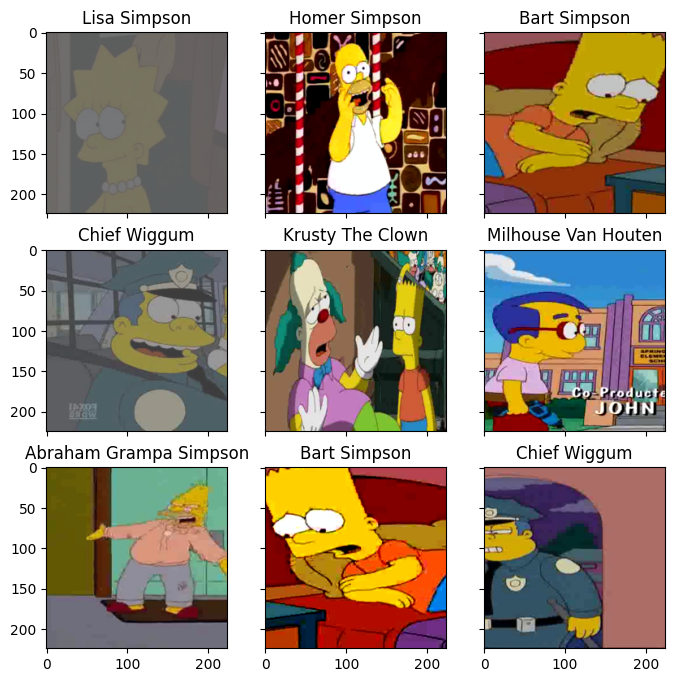

In [ ]:
fig, ax = plt.subplots(nrows=3, ncols=3,figsize=(8, 8), \
                        sharey=True, sharex=True)
for fig_x in ax.flatten():
    random_characters = int(np.random.uniform(0, 4500))
    im_val, label = image_datasets['train'][random_characters]
    # 캐릭터 이름 출력
    img_label = " ".join(map(lambda x: x.capitalize(),\
                image_datasets['val'].label_encoder.inverse_transform([label])[0].split('_')))
    imshow(im_val.data.cpu(), \
          title=img_label,plt_ax=fig_x)

adversarial patch 생성(white box)

In [ ]:
def generate_adversarial_patch(model, dataloader, patch_size, target_label, learning_rate=1.0, num_iterations=500, device='cuda'):
    """
    Generates an adversarial patch for a given dataloader with progress display.

    Args:
        model (torch.nn.Module): The target model.
        dataloader (torch.utils.data.DataLoader): The dataloader for generating patches.
        patch_size (int): The size of the square adversarial patch.
        target_label (int): The target label for the adversarial attack.
        learning_rate (float): The learning rate for optimization.
        num_iterations (int): The number of optimization iterations.
        device (str): The device to use ('cuda' or 'cpu').

    Returns:
        torch.Tensor: The generated adversarial patch.
    """
    # 랜덤한 초기 패치 생성
    adversarial_patch = torch.rand((3, patch_size, patch_size), requires_grad=True, device=device)

    optimizer = optim.Adam([adversarial_patch], lr=learning_rate)
    criterion = nn.CrossEntropyLoss()

    model.eval()

    for epoch in tqdm_notebook(range(num_iterations), desc="Generating Adversarial Patch - Epoch"):
        total_loss = 0
        # testset에 대해 적용할 때는 for문에서 labels 제거
        for inputs, labels in tqdm_notebook(dataloader, desc=f"Epoch {epoch+1}/{num_iterations}", leave=False):
            # Assume the dataloader yields only images for test/inference
            # If it yields (image, label), adjust accordingly
            images = inputs.to(device)

            # 이미지와 패치의 크기 및 패치 위치 결정
            img_h, img_w = images.shape[2:]
            patch_h, patch_w = adversarial_patch.shape[1:]
            y_pos = random.randint(0, img_h - patch_h)
            x_pos = random.randint(0, img_w - patch_w)

            # 이미지에 패치 적용
            patched_images = images.clone()
            patched_images[:, :, y_pos:y_pos+patch_h, x_pos:x_pos+patch_w] = adversarial_patch

            optimizer.zero_grad()

            # Forward pass
            outputs = model(patched_images)

            # Create target labels
            targets = torch.full((outputs.size(0),), target_label, device=device, dtype=torch.long)

            # Calculate loss (minimize the probability of the original class and maximize the probability of the target class)
            loss = criterion(outputs, targets)


            # Backward pass and optimize
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

        # Optional: Print average loss per epoch
        # print(f'Epoch [{epoch+1}/{num_iterations}], Average Loss: {total_loss / len(dataloader):.4f}')

        # Display the generated adversarial patch
        # with torch.no_grad():
        #   patch_display = copy.deepcopy(adversarial_patch).cpu().detach().numpy().transpose((1, 2, 0))
        #   # Undo normalization for visualization (using assumed Imagenet stats)
        #   mean = np.array([0.485, 0.456, 0.406])
        #   std = np.array([0.229, 0.224, 0.225])
        #   patch_display = std * patch_display + mean
        #   patch_display = np.clip(patch_display, 0, 1)

        #   plt.figure(figsize=(patch_size/50, patch_size/50))
        #   plt.imshow(patch_display)
        #   plt.title(f"Generated Adversarial Patch at epoch {epoch+1}")
        #   plt.axis('off')
        #   plt.show()
    return adversarial_patch.detach()


Targeting label: milhouse_van_houten (25)


Generating Adversarial Patch - Epoch:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch 1/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 2/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 3/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 4/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 5/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 6/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 7/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 8/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 9/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Epoch 10/10:   0%|          | 0/6280 [00:00<?, ?it/s]

Adversarial patch generated.


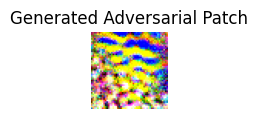

In [ ]:
patch_size = 50
#
target_label_name = 'milhouse_van_houten'

# 라벨 인코더 로드
if not os.path.exists('label_encoder.pkl'):
    print("Error: label_encoder.pkl not found. Please ensure it's generated during dataset loading.")
    pass
else:
    with open('label_encoder.pkl', 'rb') as le_dump_file:
        label_encoder = pickle.load(le_dump_file)
        # 라벨 인코더로 타겟 라벨 불러오기
        target_label = label_encoder.transform([target_label_name]).item()
        print(f"Targeting label: {target_label_name} ({target_label})")

        # 패치 생성
        adversarial_patch = generate_adversarial_patch(
            model=model,
            dataloader=dataloaders_dict['val'],
            #dataloader=dataloader_test,  # Using the test dataloader for patch generation
            patch_size=patch_size,
            target_label=target_label,
            learning_rate=0.1,  # Adjust learning rate as needed
            num_iterations=10, # Adjust iterations as needed
            device=device
        )

        print("Adversarial patch generated.")

        # 생성된 패치 시각화
        patch_display = adversarial_patch.cpu().numpy().transpose((1, 2, 0))
        # denormalize
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        patch_display = std * patch_display + mean
        patch_display = np.clip(patch_display, 0, 1)

        plt.figure(figsize=(patch_size/50, patch_size/50))
        plt.imshow(patch_display)
        plt.title("Generated Adversarial Patch")
        plt.axis('off')
        plt.show()

저장 및 불러오기

In [ ]:
# 생성된 adversarial patch 저장
# Assuming 'adversarial_patch' variable contains the generated patch tensor
if 'adversarial_patch' in locals():
    save_path = 'adversarial_patch.pt'
    torch.save(adversarial_patch, save_path)
    print(f"Adversarial patch saved as {save_path}")
else:
    print("Adversarial patch not generated yet. Please run the patch generation code.")


Adversarial patch saved as adversarial_patch.pt


Adversarial patch loaded from adversarial_patch.pt


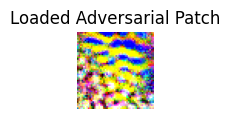

In [ ]:
# 저장된 adversarial patch 불러오기
load_path = 'adversarial_patch.pt'
if os.path.exists(load_path):
    loaded_adversarial_patch = torch.load(load_path, map_location=device)
    print(f"Adversarial patch loaded from {load_path}")

    # You can now use loaded_adversarial_patch
    # For example, display it to verify
    patch_display_loaded = loaded_adversarial_patch.cpu().numpy().transpose((1, 2, 0))
    # Undo normalization for visualization (using assumed Imagenet stats)
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    patch_display_loaded = std * patch_display_loaded + mean
    patch_display_loaded = np.clip(patch_display_loaded, 0, 1)

    plt.figure(figsize=(patch_size/50, patch_size/50))
    plt.imshow(patch_display_loaded)
    plt.title("Loaded Adversarial Patch")
    plt.axis('off')
    plt.show()

else:
    print(f"Adversarial patch file not found at {load_path}. Please ensure the patch was saved.")


테스트셋에 패치 적용

In [ ]:
# 패치 적용된 이미지 저장
output_dir = '/content/adv_test'
os.makedirs(output_dir, exist_ok=True)

# 패치가 적용된 부분만 따와서 회색으로 덮은 대조군
control_dir = '/content/control_test'
os.makedirs(control_dir, exist_ok=True)

print("Applying adversarial patch to test dataset and saving...")

# 기존 테스트셋
test_image_paths = image_datasets_test.files_path

with torch.no_grad(): # No gradient calculation needed for applying the patch
    for i, inputs in tqdm_notebook(enumerate(dataloader_test), total=len(dataloader_test), desc="Applying Patch"):
        images = inputs.to(device)

        # Assuming batch size is 1 for simplicity in this loop
        image = images[0]

        # 패치를 적용할 픽셀을 랜덤하게 결정
        img_h, img_w = image.shape[1:]
        patch_h, patch_w = loaded_adversarial_patch.shape[1:]
        y_pos = random.randint(0, img_h - patch_h)
        x_pos = random.randint(0, img_w - patch_w)

        # 패치 적용
        patched_image_tensor = image.clone()
        patched_image_tensor[:, y_pos:y_pos+patch_h, x_pos:x_pos+patch_w] = loaded_adversarial_patch.squeeze(0)

        control_image_tensor = image.clone()
        blank_tensor = torch.zeros_like(loaded_adversarial_patch)
        control_image_tensor[:, y_pos:y_pos+patch_h, x_pos:x_pos+patch_w] = blank_tensor.squeeze(0)

        # denormalize하여 이미지 저장
        mean = torch.tensor([0.485, 0.456, 0.406]).to(device).view(3, 1, 1)
        std = torch.tensor([0.229, 0.224, 0.225]).to(device).view(3, 1, 1)
        patched_image_denormalized = patched_image_tensor * std + mean
        patched_image_denormalized = torch.clamp(patched_image_denormalized, 0, 1) # Clamp values to [0, 1]

        control_image_denormalized = control_image_tensor * std + mean
        control_image_denormalized = torch.clamp(control_image_denormalized, 0, 1) # Clamp values to [0, 1]

        # Convert to PIL Image (transpose from C, H, W to H, W, C and then to uint8)
        patched_image_pil = transforms.ToPILImage()(patched_image_denormalized.cpu())
        control_image_pil = transforms.ToPILImage()(control_image_denormalized.cpu())

        # Get the original filename and construct the new filename
        original_file_path = test_image_paths[i]
        original_filename = os.path.basename(original_file_path)
        filename_without_ext, file_extension = os.path.splitext(original_filename)

        new_filename = f"{filename_without_ext}_patched{file_extension}"
        control_filename = f"{filename_without_ext}_control{file_extension}"

        output_path = os.path.join(output_dir, new_filename)
        control_output_path = os.path.join(control_dir, control_filename)

        # Save the patched image
        patched_image_pil.save(output_path)
        control_image_pil.save(control_output_path)

print(f"Patched images saved to {output_dir}")
print(f"Control images saved to {control_dir}")


Applying adversarial patch to test dataset and saving...


Applying Patch:   0%|          | 0/990 [00:00<?, ?it/s]

Patched images saved to /content/adv_test
Control images saved to /content/control_test


patched testset 예측

In [ ]:
import os
import pandas as pd
import torch
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from tqdm.notebook import tqdm
import pickle

# 패치가 적용된 이미지
adv_test_dir = '/content/adv_test'

if not os.path.exists(adv_test_dir):
    print(f"Error: The directory '{adv_test_dir}' does not exist.")
else:
    adv_image_files = [os.path.join(adv_test_dir, f) for f in os.listdir(adv_test_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

    if not adv_image_files:
        print(f"No image files found in '{adv_test_dir}'.")
    else:
        print(f"Found {len(adv_image_files)} patched images in '{adv_test_dir}'.")

        label_encoder_path = 'label_encoder.pkl'
        if not os.path.exists(label_encoder_path):
            print(f"Error: Label encoder file '{label_encoder_path}' not found.")
        else:
            with open(label_encoder_path, 'rb') as le_dump_file:
                label_encoder = pickle.load(le_dump_file)

            # Create a dataset and dataloader for the adversarial test images
            # Use the same transformation as 'val' or 'test'
            input_size = 224
            adv_test_transforms = transforms.Compose([
                transforms.Resize((input_size, input_size)),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
            ])

            class SimpleImageDataset(Dataset):
                def __init__(self, file_paths, transform=None):
                    self.file_paths = file_paths
                    self.transform = transform

                def __len__(self):
                    return len(self.file_paths)

                def __getitem__(self, idx):
                    img_path = self.file_paths[idx]
                    image = Image.open(img_path).convert('RGB') # Ensure RGB
                    if self.transform:
                        image = self.transform(image)
                    return image, os.path.basename(img_path) # Return image tensor and filename

            adv_test_dataset = SimpleImageDataset(adv_image_files, transform=adv_test_transforms)

            # Use batch_size=1 for simplicity to match predictions with filenames easily
            adv_dataloader = DataLoader(adv_test_dataset, batch_size=1, shuffle=False, num_workers=num_workers)

            # Lists to store results
            results = []

            print("Predicting on adversarial test images...")
            with torch.no_grad():
                model.eval() # Set model to evaluation mode
                for inputs, filenames in tqdm(adv_dataloader, desc="Predicting"):
                    images = inputs.to(device)

                    # Get model predictions
                    outputs = model(images)

                    # Apply softmax to get probabilities
                    probabilities = F.softmax(outputs, dim=1)

                    # Get top 5 predictions and their probabilities
                    top5_prob, top5_indices = torch.topk(probabilities, 5, dim=1)

                    # Convert indices to class labels
                    top5_labels = [label_encoder.inverse_transform([idx.item() for idx in indices]) for indices in top5_indices]

                    # Store results for the current image
                    for i in range(inputs.size(0)): # Iterate through batch (should be 1)
                        filename = filenames[i].rsplit('_', 2)[0]
                        top5_prob_list = top5_prob[i].cpu().numpy().tolist()
                        top5_labels_list = top5_labels[i].tolist()

                        results.append({
                            'filename': filename,
                            'top5_labels': top5_labels_list,
                            'top5_probabilities': top5_prob_list
                        })

            # Create a pandas DataFrame from the results
            results_df = pd.DataFrame(results)

            # Save the results to a CSV file
            results_csv_path = '/content/adv_test_top5_predictions.csv'
            results_df.to_csv(results_csv_path, index=False)

            print(f"Top 5 prediction labels and probabilities saved to '{results_csv_path}'")

            # Display the first few rows of the results
            print("\nSample of the prediction results:")
            print(results_df.head())

Found 990 patched images in '/content/adv_test'.
Predicting on adversarial test images...


Predicting:   0%|          | 0/990 [00:00<?, ?it/s]

Top 5 prediction labels and probabilities saved to '/content/adv_test_top5_predictions.csv'

Sample of the prediction results:
                   filename  \
0  charles_montgomery_burns   
1              chief_wiggum   
2       milhouse_van_houten   
3              bart_simpson   
4  charles_montgomery_burns   

                                         top5_labels  \
0  [milhouse_van_houten, charles_montgomery_burns...   
1  [milhouse_van_houten, marge_simpson, chief_wig...   
2  [milhouse_van_houten, marge_simpson, charles_m...   
3  [milhouse_van_houten, charles_montgomery_burns...   
4  [charles_montgomery_burns, milhouse_van_houten...   

                                  top5_probabilities  
0  [0.9895340800285339, 0.01029068324714899, 8.85...  
1  [1.0, 3.255349056985324e-08, 1.837805428672734...  
2  [1.0, 3.033479956116025e-08, 5.915145040447101...  
3  [0.9999998807907104, 7.481959585220466e-08, 8....  
4  [0.9815667867660522, 0.01843320019543171, 9.05...  


control testset 예측

In [ ]:
# Define the directory containing the adversarially patched images
control_test_dir = '/content/control_test'

# Check if the directory exists
if not os.path.exists(control_test_dir):
    print(f"Error: The directory '{control_test_dir}' does not exist.")
else:
    # Create a list of file paths for the patched images
    adv_image_files = [os.path.join(control_test_dir, f) for f in os.listdir(control_test_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

    if not adv_image_files:
        print(f"No image files found in '{control_test_dir}'.")
    else:
        print(f"Found {len(adv_image_files)} patched images in '{control_test_dir}'.")

        # Load the label encoder
        label_encoder_path = 'label_encoder.pkl'
        if not os.path.exists(label_encoder_path):
            print(f"Error: Label encoder file '{label_encoder_path}' not found.")
            # You might need to re-run the dataset loading section to generate it
        else:
            with open(label_encoder_path, 'rb') as le_dump_file:
                label_encoder = pickle.load(le_dump_file)

            # Create a dataset and dataloader for the adversarial test images
            # Use the same transformation as 'val' or 'test'
            input_size = 224
            adv_test_transforms = transforms.Compose([
                transforms.Resize((input_size, input_size)),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
            ])

            class SimpleImageDataset(Dataset):
                def __init__(self, file_paths, transform=None):
                    self.file_paths = file_paths
                    self.transform = transform

                def __len__(self):
                    return len(self.file_paths)

                def __getitem__(self, idx):
                    img_path = self.file_paths[idx]
                    image = Image.open(img_path).convert('RGB') # Ensure RGB
                    if self.transform:
                        image = self.transform(image)
                    return image, os.path.basename(img_path) # Return image tensor and filename

            adv_test_dataset = SimpleImageDataset(adv_image_files, transform=adv_test_transforms)

            # Use batch_size=1 for simplicity to match predictions with filenames easily
            adv_dataloader = DataLoader(adv_test_dataset, batch_size=1, shuffle=False, num_workers=num_workers)

            # Lists to store results
            results = []

            print("Predicting on control test images...")
            with torch.no_grad():
                model.eval() # Set model to evaluation mode
                for inputs, filenames in tqdm(adv_dataloader, desc="Predicting"):
                    images = inputs.to(device)

                    # Get model predictions
                    outputs = model(images)

                    # Apply softmax to get probabilities
                    probabilities = F.softmax(outputs, dim=1)

                    # Get top 5 predictions and their probabilities
                    top5_prob, top5_indices = torch.topk(probabilities, 5, dim=1)

                    # Convert indices to class labels
                    top5_labels = [label_encoder.inverse_transform([idx.item() for idx in indices]) for indices in top5_indices]

                    # Store results for the current image
                    for i in range(inputs.size(0)): # Iterate through batch (should be 1)
                        filename = filenames[i].rsplit('_', 2)[0]
                        top5_prob_list = top5_prob[i].cpu().numpy().tolist()
                        top5_labels_list = top5_labels[i].tolist()

                        results.append({
                            'filename': filename,
                            'top5_labels': top5_labels_list,
                            'top5_probabilities': top5_prob_list
                        })

            # Create a pandas DataFrame from the results
            results_df = pd.DataFrame(results)

            # Save the results to a CSV file
            results_csv_path = '/content/control_test_top5_predictions.csv'
            results_df.to_csv(results_csv_path, index=False)

            print(f"Top 5 prediction labels and probabilities saved to '{results_csv_path}'")

            # Display the first few rows of the results
            print("\nSample of the prediction results:")
            print(results_df.head())

Found 990 patched images in '/content/control_test'.
Predicting on control test images...


Predicting:   0%|          | 0/990 [00:00<?, ?it/s]

Top 5 prediction labels and probabilities saved to '/content/control_test_top5_predictions.csv'

Sample of the prediction results:
                 filename                                        top5_labels  \
0            sideshow_bob  [sideshow_bob, ned_flanders, cletus_spuckler, ...   
1           kent_brockman  [kent_brockman, principal_skinner, gil, ground...   
2  apu_nahasapeemapetilon  [apu_nahasapeemapetilon, carl_carlson, grounds...   
3  abraham_grampa_simpson  [abraham_grampa_simpson, lenny_leonard, homer_...   
4           lenny_leonard  [lenny_leonard, ned_flanders, homer_simpson, b...   

                                  top5_probabilities  
0  [0.8165327906608582, 0.12702780961990356, 0.02...  
1  [0.8510380387306213, 0.052520886063575745, 0.0...  
2  [0.9995274543762207, 0.000465106510091573, 6.9...  
3  [1.0, 5.507058142839583e-10, 1.045418265843700...  
4  [0.9999912977218628, 4.405255822348408e-06, 4....  


original testset 예측

In [ ]:
# Define the directory containing the adversarially patched images
test_dir = '/kaggle/input/the-simpsons-characters-dataset/kaggle_simpson_testset/kaggle_simpson_testset'

# Check if the directory exists
if not os.path.exists(test_dir):
    print(f"Error: The directory '{test_dir}' does not exist.")
else:
    # Create a list of file paths for the patched images
    adv_image_files = [os.path.join(test_dir, f) for f in os.listdir(test_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

    if not adv_image_files:
        print(f"No image files found in '{test_dir}'.")
    else:
        print(f"Found {len(adv_image_files)} patched images in '{test_dir}'.")

        # Load the label encoder
        label_encoder_path = 'label_encoder.pkl'
        if not os.path.exists(label_encoder_path):
            print(f"Error: Label encoder file '{label_encoder_path}' not found.")
            # You might need to re-run the dataset loading section to generate it
        else:
            with open(label_encoder_path, 'rb') as le_dump_file:
                label_encoder = pickle.load(le_dump_file)

            # Create a dataset and dataloader for the adversarial test images
            # Use the same transformation as 'val' or 'test'
            input_size = 224
            adv_test_transforms = transforms.Compose([
                transforms.Resize((input_size, input_size)),
                transforms.ToTensor(),
                transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
            ])

            class SimpleImageDataset(Dataset):
                def __init__(self, file_paths, transform=None):
                    self.file_paths = file_paths
                    self.transform = transform

                def __len__(self):
                    return len(self.file_paths)

                def __getitem__(self, idx):
                    img_path = self.file_paths[idx]
                    image = Image.open(img_path).convert('RGB') # Ensure RGB
                    if self.transform:
                        image = self.transform(image)
                    return image, os.path.basename(img_path) # Return image tensor and filename

            adv_test_dataset = SimpleImageDataset(adv_image_files, transform=adv_test_transforms)

            # Use batch_size=1 for simplicity to match predictions with filenames easily
            adv_dataloader = DataLoader(adv_test_dataset, batch_size=1, shuffle=False, num_workers=num_workers)

            # Lists to store results
            results = []

            print("Predicting on original test images...")
            with torch.no_grad():
                model.eval() # Set model to evaluation mode
                for inputs, filenames in tqdm(adv_dataloader, desc="Predicting"):
                    images = inputs.to(device)

                    # Get model predictions
                    outputs = model(images)

                    # Apply softmax to get probabilities
                    probabilities = F.softmax(outputs, dim=1)

                    # Get top 5 predictions and their probabilities
                    top5_prob, top5_indices = torch.topk(probabilities, 5, dim=1)

                    # Convert indices to class labels
                    top5_labels = [label_encoder.inverse_transform([idx.item() for idx in indices]) for indices in top5_indices]

                    # Store results for the current image
                    for i in range(inputs.size(0)): # Iterate through batch (should be 1)
                        filename = filenames[i].rsplit('_', 1)[0]
                        top5_prob_list = top5_prob[i].cpu().numpy().tolist()
                        top5_labels_list = top5_labels[i].tolist()

                        results.append({
                            'filename': filename,
                            'top5_labels': top5_labels_list,
                            'top5_probabilities': top5_prob_list
                        })

            # Create a pandas DataFrame from the results
            results_df = pd.DataFrame(results)

            # Save the results to a CSV file
            results_csv_path = '/content/original_test_top5_predictions.csv'
            results_df.to_csv(results_csv_path, index=False)

            print(f"Top 5 prediction labels and probabilities saved to '{results_csv_path}'")

            # Display the first few rows of the results
            print("\nSample of the prediction results:")
            print(results_df.head())

Found 990 patched images in '/kaggle/input/the-simpsons-characters-dataset/kaggle_simpson_testset/kaggle_simpson_testset'.
Predicting on original test images...


Predicting:   0%|          | 0/990 [00:00<?, ?it/s]

Top 5 prediction labels and probabilities saved to '/content/original_test_top5_predictions.csv'

Sample of the prediction results:
                 filename                                        top5_labels  \
0     milhouse_van_houten  [milhouse_van_houten, charles_montgomery_burns...   
1  apu_nahasapeemapetilon  [apu_nahasapeemapetilon, groundskeeper_willie,...   
2        krusty_the_clown  [krusty_the_clown, chief_wiggum, sideshow_mel,...   
3           lenny_leonard  [lenny_leonard, ned_flanders, abraham_grampa_s...   
4           marge_simpson  [marge_simpson, moe_szyslak, homer_simpson, pa...   

                                  top5_probabilities  
0  [0.9999992847442627, 2.4132660314535315e-07, 1...  
1  [0.9999995231628418, 4.784464522344933e-07, 4....  
2  [0.999998927116394, 4.3970726437692065e-07, 3....  
3  [1.0, 6.074752256779448e-09, 2.173593305343502...  
4  [0.5224477648735046, 0.3713921010494232, 0.040...  


original testset과 patched testset의 acc 비교

In [ ]:
import pandas as pd
import ast
# Load the prediction CSV files
original_predictions_df = pd.read_csv('/content/original_test_top5_predictions.csv')
adv_predictions_df = pd.read_csv('/content/adv_test_top5_predictions.csv')
control_predictions_df = pd.read_csv('/content/control_test_top5_predictions.csv')

# Function to extract the true label from the filename
def extract_true_label(filename):
    # Assumes filename format is 'true_label_rest_of_filename.ext'
    # Example: 'homer_simpson_0.jpg' -> 'homer_simpson'
    # Example: 'abraham_grampa_simpson_100.jpg' -> 'abraham_grampa_simpson'
    # Split by '_' and take the first part(s) until a number or the last part
    parts = filename.split('_')
    true_label_parts = []
    for part in parts:
        if part.isdigit():
            break
        true_label_parts.append(part)
    return '_'.join(true_label_parts)

# Add the true label column to each DataFrame
original_predictions_df['true_label'] = original_predictions_df['filename'].apply(extract_true_label)
adv_predictions_df['true_label'] = adv_predictions_df['filename'].apply(extract_true_label)
control_predictions_df['true_label'] = control_predictions_df['filename'].apply(extract_true_label)

# Function to evaluate top-k accuracy
def calculate_topk_accuracy(df, k=5):
    correct_count = 0
    for index, row in df.iterrows():
        true_label = row['true_label']
        # The 'top5_labels' column is stored as a string representation of a list
        # Need to convert it back to a list
        topk_labels_str = row[f'top5_labels']
        # Use ast.literal_eval to safely parse the string list
        try:
            topk_labels = ast.literal_eval(topk_labels_str)
        except (ValueError, SyntaxError):
            # Handle cases where parsing fails, maybe log a warning
            print(f"Warning: Could not parse top5_labels string: {topk_labels_str}")
            continue # Skip this row

        if true_label in topk_labels[:k]:
            correct_count += 1
    accuracy = correct_count / len(df)
    return accuracy

# Calculate Top-1 accuracy for both datasets

for k in [1,3,5]:
  original_topk_accuracy = calculate_topk_accuracy(original_predictions_df, k)
  adv_topk_accuracy = calculate_topk_accuracy(adv_predictions_df, k)
  control_topk_accuracy = calculate_topk_accuracy(control_predictions_df, k)

  print(f"Top-{k} Accuracy on Original Test Set: {original_topk_accuracy:.4f}")
  print(f"Top-{k} Accuracy on Adversarial Test Set: {adv_topk_accuracy:.4f}")
  print(f"Top-{k} Accuracy on Control Test Set: {control_topk_accuracy:.4f}\n")

Top-1 Accuracy on Original Test Set: 0.9808
Top-1 Accuracy on Adversarial Test Set: 0.0586
Top-1 Accuracy on Control Test Set: 0.9576

Top-3 Accuracy on Original Test Set: 0.9939
Top-3 Accuracy on Adversarial Test Set: 0.4646
Top-3 Accuracy on Control Test Set: 0.9859

Top-5 Accuracy on Original Test Set: 0.9939
Top-5 Accuracy on Adversarial Test Set: 0.5697
Top-5 Accuracy on Control Test Set: 0.9909



In [ ]:
import torch
import torch.nn.functional as F
from PIL import Image
import numpy as np

class GradCAM:
    def __init__(self, model, target_layer_name):
        """
        model: PyTorch 분류 모델
        target_layer_name: Grad-CAM을 구할 convolution 레이어 이름 (예: "layer4")
        """
        self.model = model
        self.model.eval()
        self.target_layer_name = target_layer_name

        # forward hook, backward hook에서 기록할 placeholder
        self.fmap = None
        self.grad = None

        # 지정된 레이어에 hook 등록
        for name, module in self.model.named_modules():
            if name == self.target_layer_name:
                module.register_forward_hook(self._forward_hook)
                module.register_backward_hook(self._backward_hook)

    def _forward_hook(self, module, input, output):
        # forward 시, feature map(output)을 저장
        self.fmap = output.detach()

    def _backward_hook(self, module, grad_input, grad_output):
        # backward 시, gradients(grad_output[0])를 저장
        self.grad = grad_output[0].detach()

    def generate(self, input_tensor, target_class=None):
        """
        input_tensor: (1, 3, H, W) 형태, 이미 Normalize된 상태여야 함
        target_class: None이면 모델이 예측한 top-1 클래스를 내부에서 사용
        return:
            heatmap_resized: (H, W) 형태의 numpy 배열(0~1 범위)
            target_class: 실제로 사용된 class 인덱스
        """
        # 1) forward → softmax 확률 구하기
        logits = self.model(input_tensor)            # (1, num_classes)
        probs = F.softmax(logits, dim=1)
        if target_class is None:
            _, target_class = torch.max(probs, dim=1)
            target_class = target_class.item()

        # 2) 해당 클래스 스코어에 대해 backward
        self.model.zero_grad()
        score = logits[0, target_class]
        score.backward(retain_graph=True)

        # 3) hook으로 저장된 fmap, grad 가져오기
        fmap = self.fmap[0]   # (C, h, w)
        grad = self.grad[0]   # (C, h, w)

        # 4) 채널별 평균 gradient → weight 계산
        weights = torch.mean(grad.view(grad.shape[0], -1), dim=1)  # (C,)

        # 5) fmap에 가중합
        cam = torch.zeros(fmap.shape[1:], dtype=torch.float32, device=fmap.device)  # (h, w)
        for i, w in enumerate(weights):
            cam += w * fmap[i, :, :]

        # 6) ReLU → normalize
        cam = F.relu(cam)
        cam -= cam.min()
        if cam.max() > 0:
            cam /= cam.max()
        heatmap = cam.cpu().numpy()  # (h, w), 0~1

        # 7) input_tensor의 원본 H, W 크기로 업샘플
        _, _, H, W = input_tensor.shape
        heatmap_resized = (
            Image.fromarray(np.uint8(heatmap * 255))
            .resize((W, H), resample=Image.BILINEAR)
        )
        heatmap_resized = np.array(heatmap_resized) / 255.0
        return heatmap_resized, target_class


adv_test 데이터와 original testset의 gradcam 비교


Found 990 pairs of original and adversarial images.

Comparing: milhouse_van_houten_19


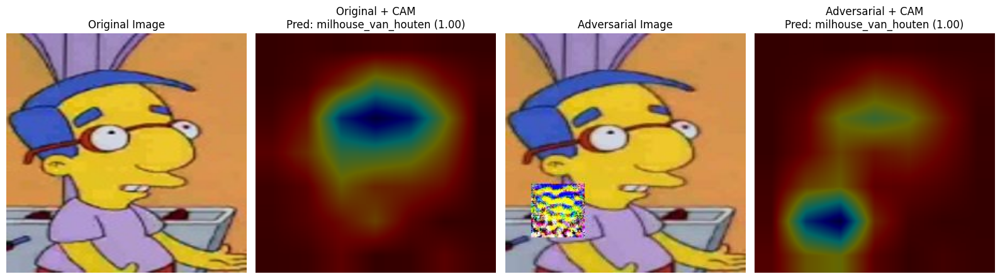


Comparing: lenny_leonard_48


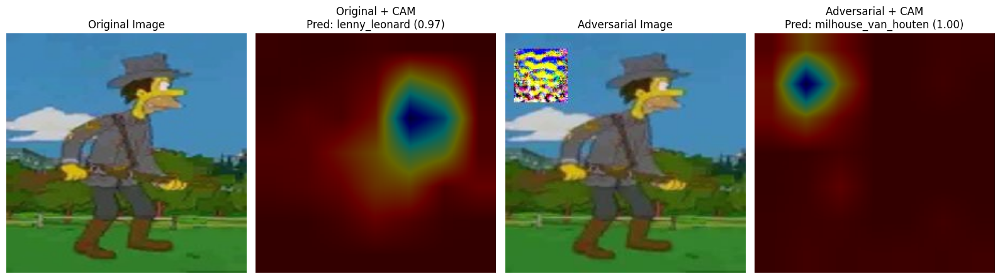


Comparing: apu_nahasapeemapetilon_13


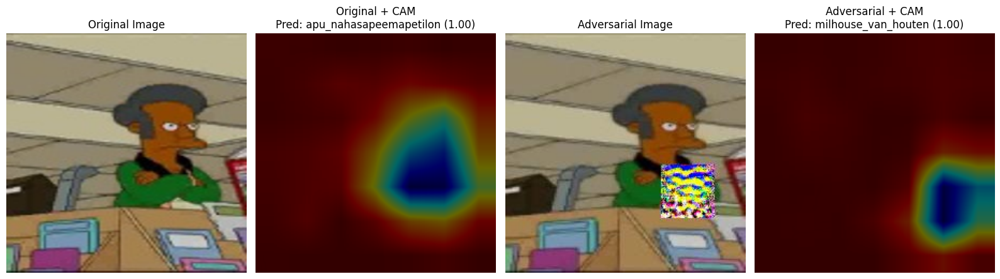


Comparing: chief_wiggum_31


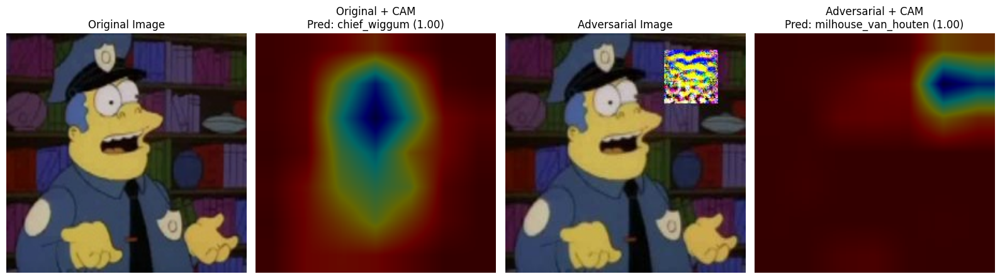


Comparing: bart_simpson_17


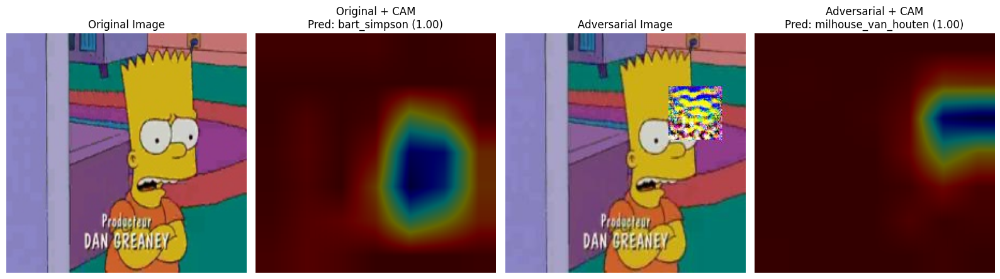


Comparing: bart_simpson_6


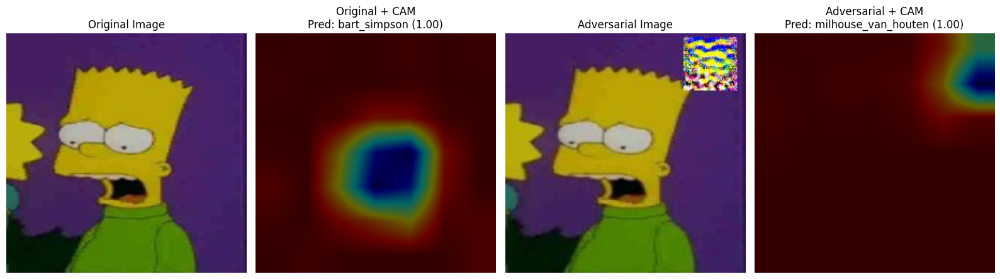


Comparing: marge_simpson_26


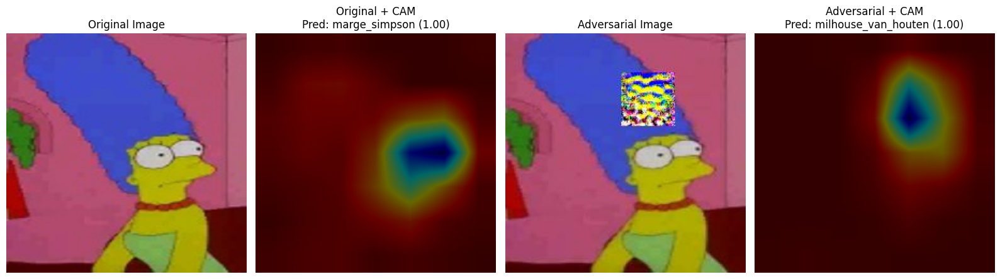


Comparing: charles_montgomery_burns_4


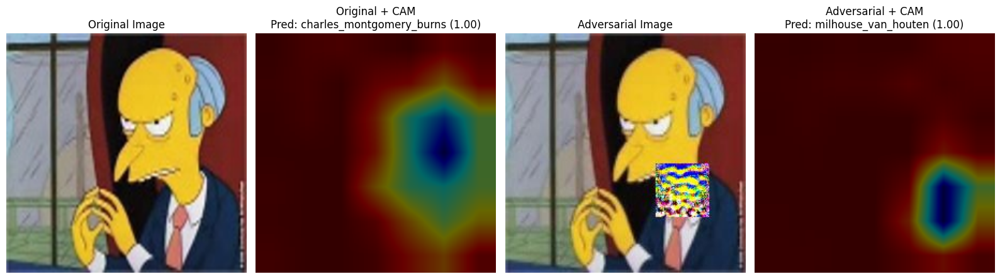


Comparing: chief_wiggum_12


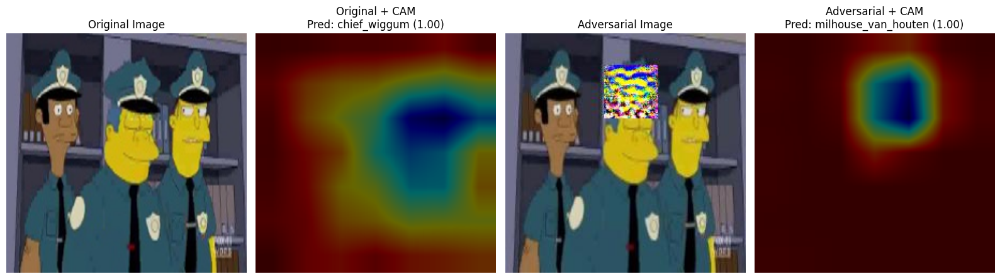


Comparing: ned_flanders_35


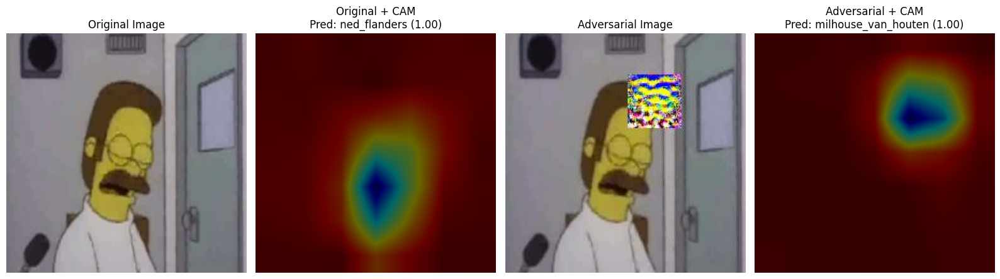


Comparing: chief_wiggum_39


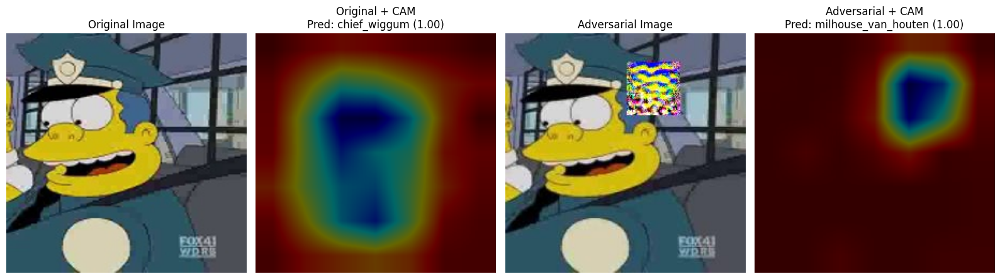


Comparing: charles_montgomery_burns_44


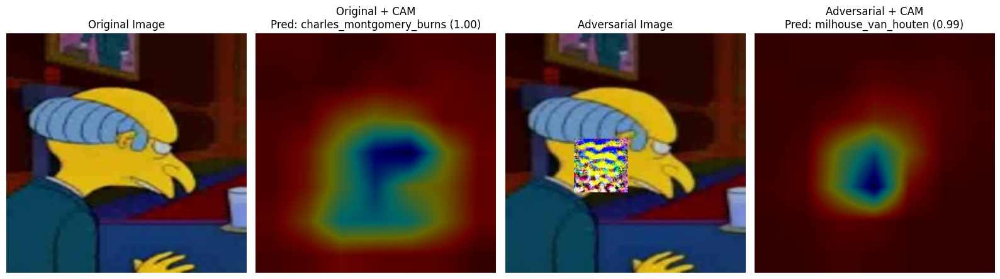


Comparing: ned_flanders_49


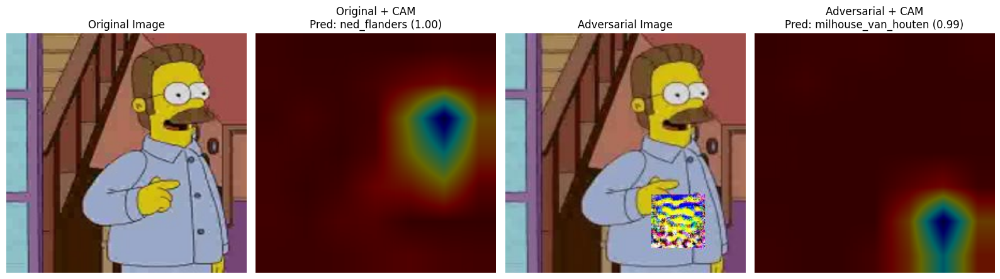


Comparing: lisa_simpson_41


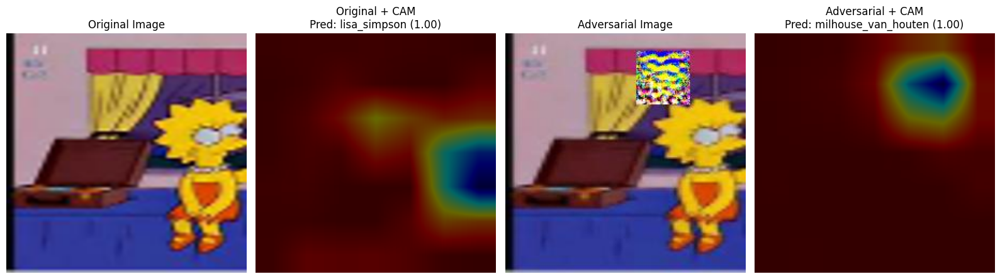


Comparing: marge_simpson_21


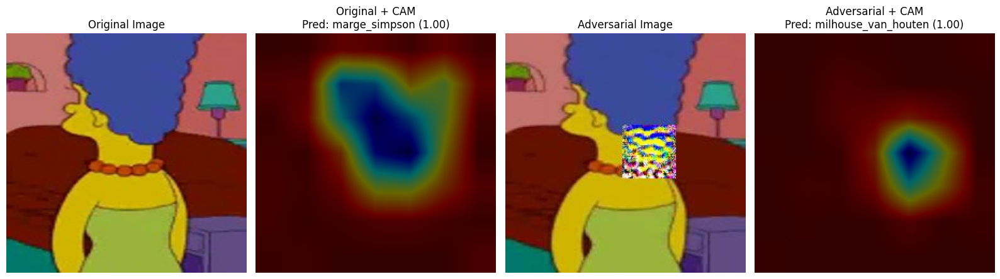


Comparing: ned_flanders_28


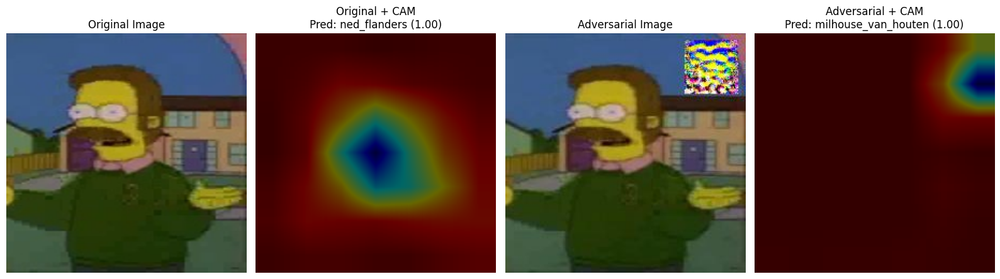


Comparing: bart_simpson_13


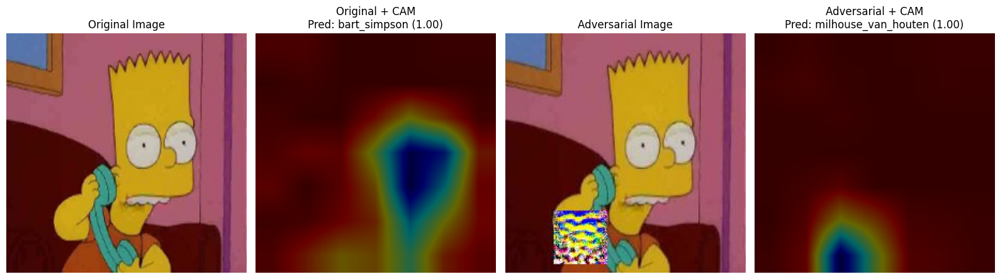


Comparing: principal_skinner_38


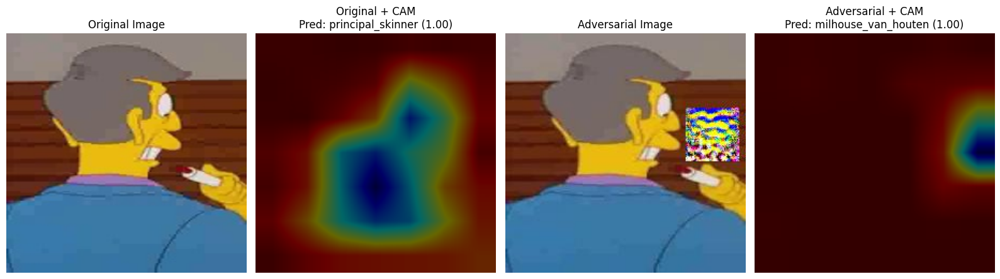


Comparing: abraham_grampa_simpson_38


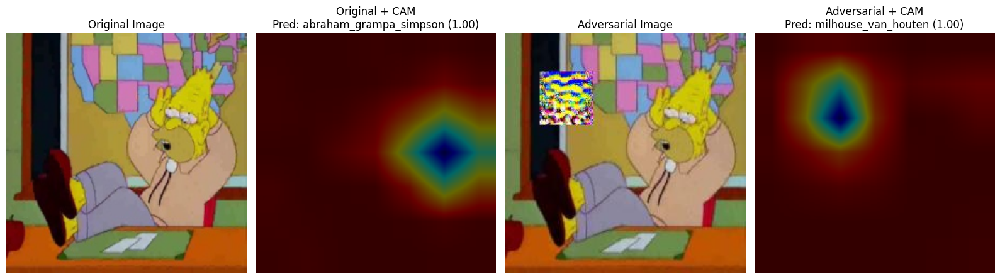


Comparing: mayor_quimby_38


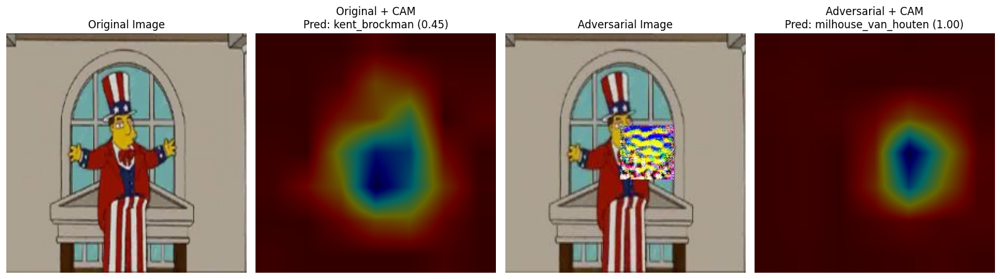


Comparing: homer_simpson_20


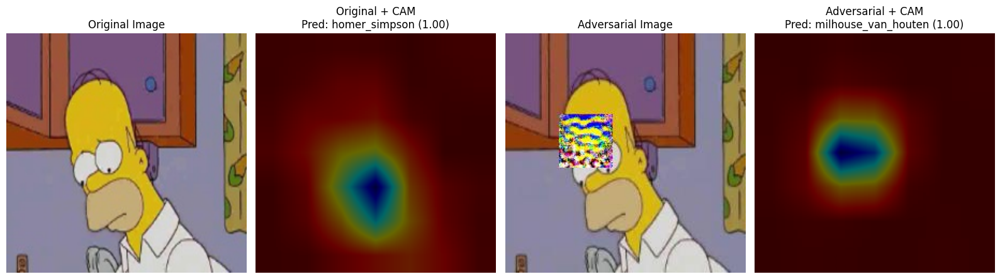


Comparing: homer_simpson_14


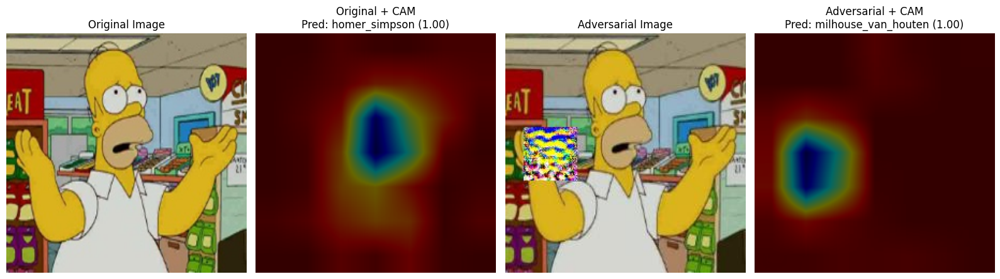


Comparing: mayor_quimby_3


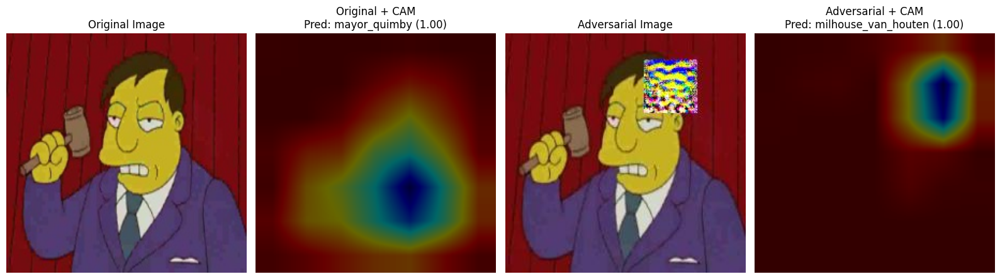


Comparing: milhouse_van_houten_15


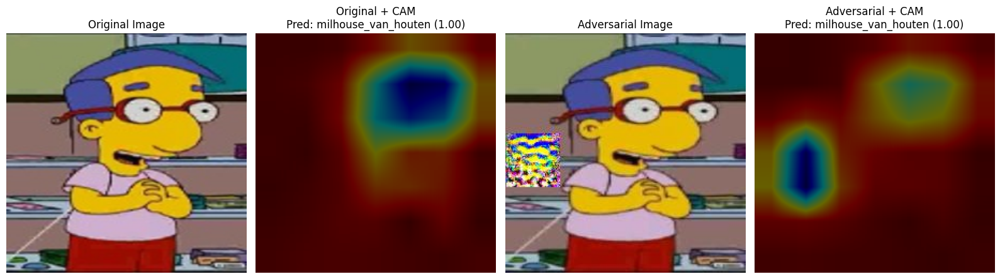


Comparing: krusty_the_clown_9


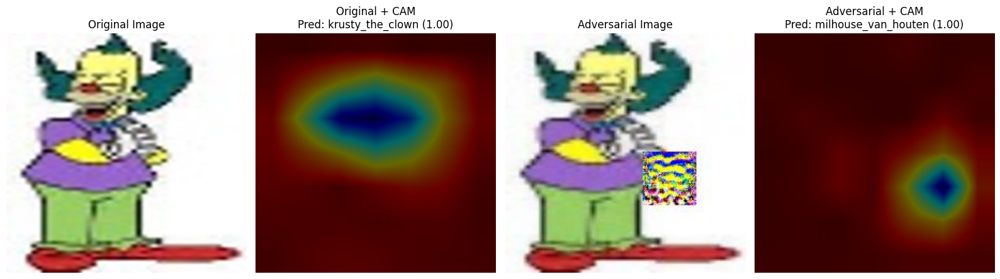


Comparing: sideshow_bob_34


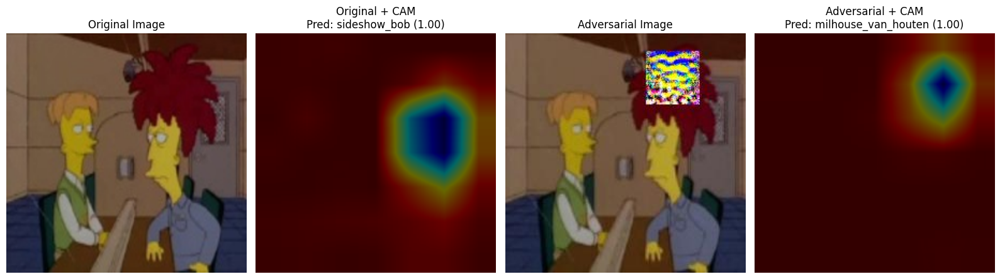


Comparing: comic_book_guy_9


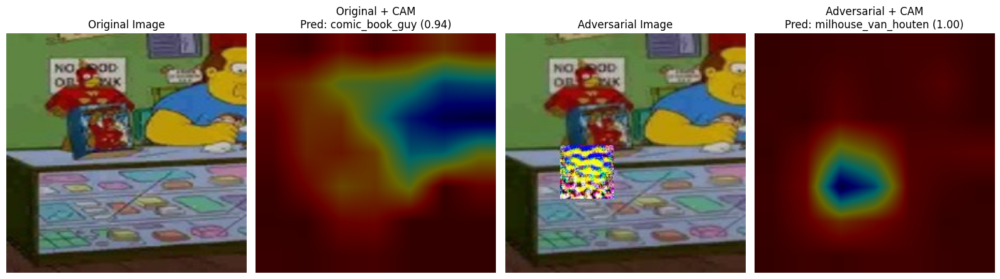


Comparing: kent_brockman_31


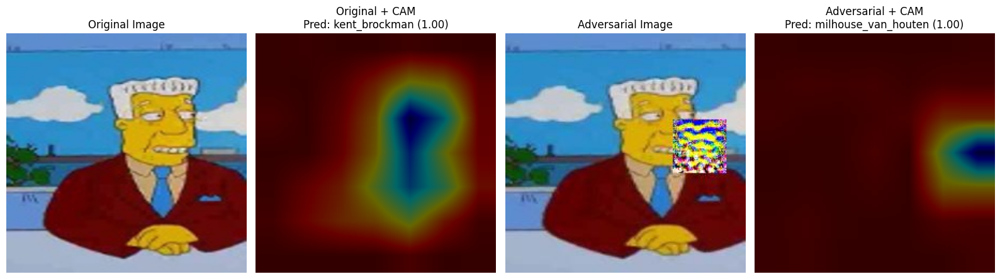


Comparing: marge_simpson_19


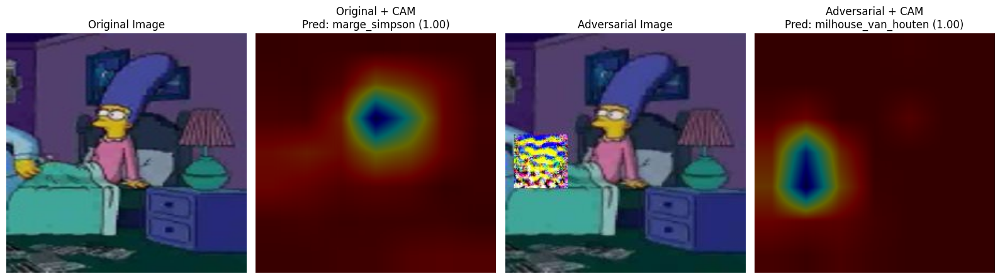


Comparing: principal_skinner_41


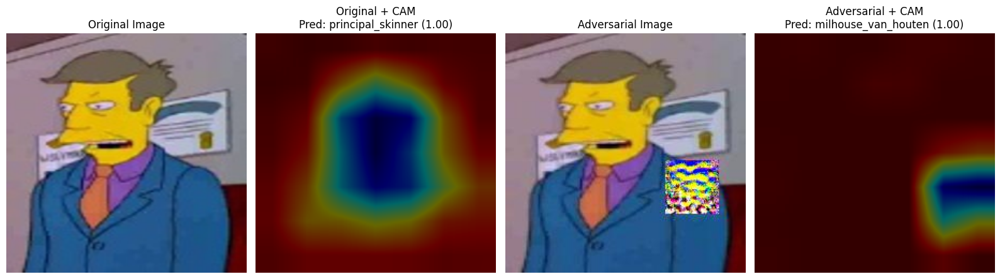


Comparing: sideshow_bob_16


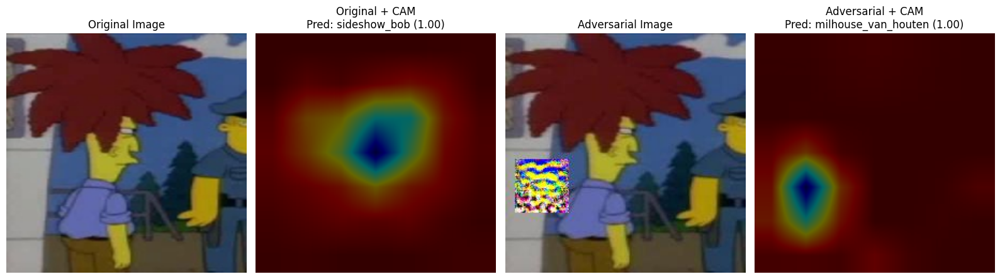


Comparing: comic_book_guy_0


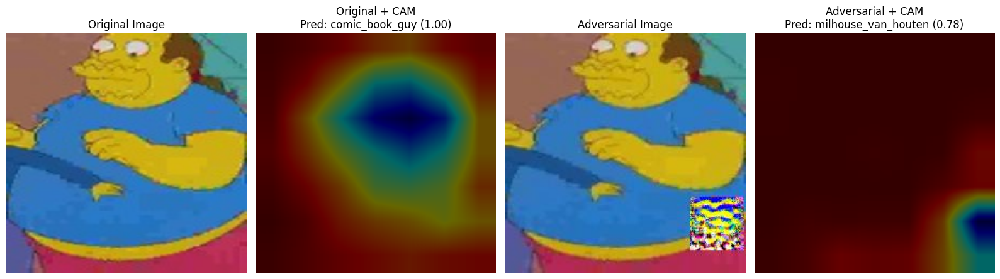


Comparing: chief_wiggum_18


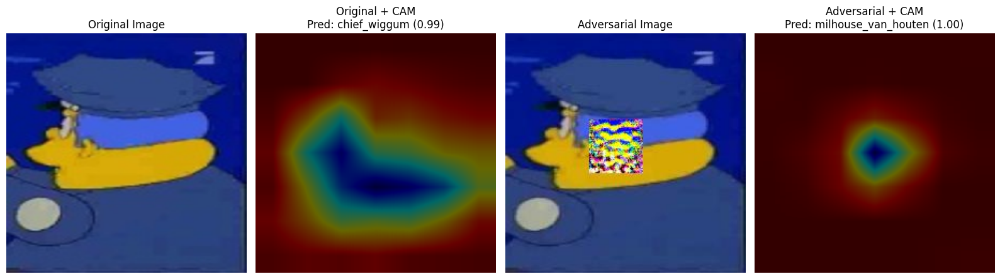


Comparing: principal_skinner_45


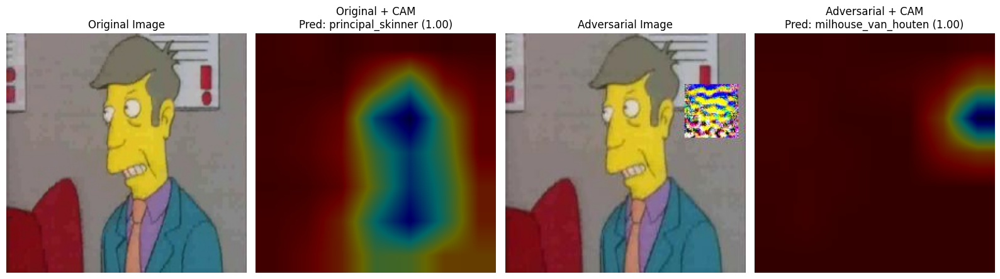


Comparing: krusty_the_clown_42


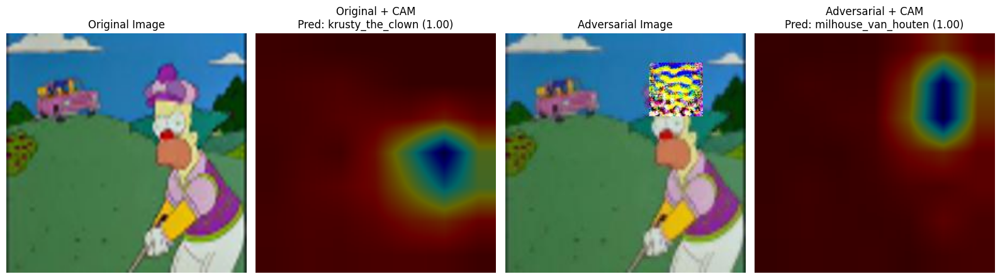


Comparing: comic_book_guy_24


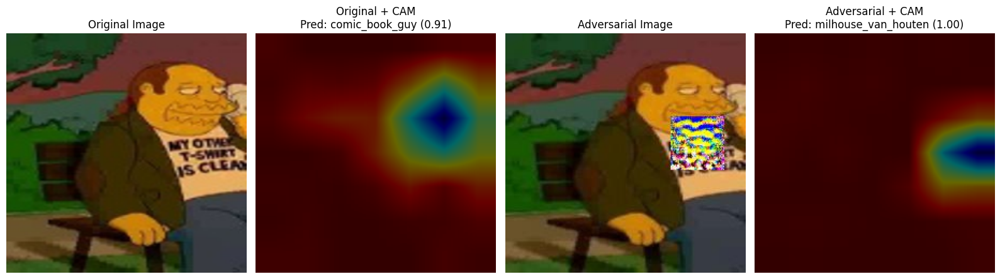


Comparing: comic_book_guy_33


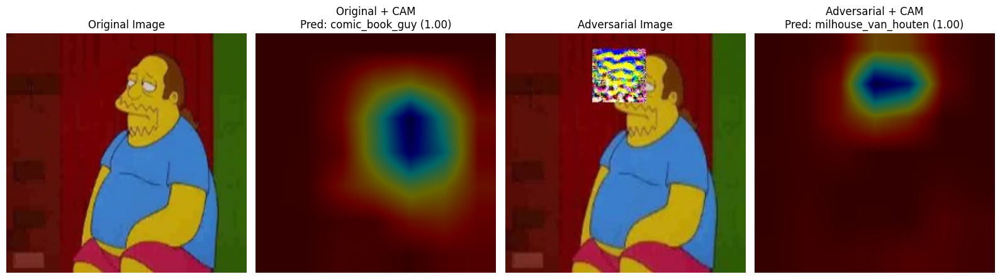


Comparing: sideshow_bob_19


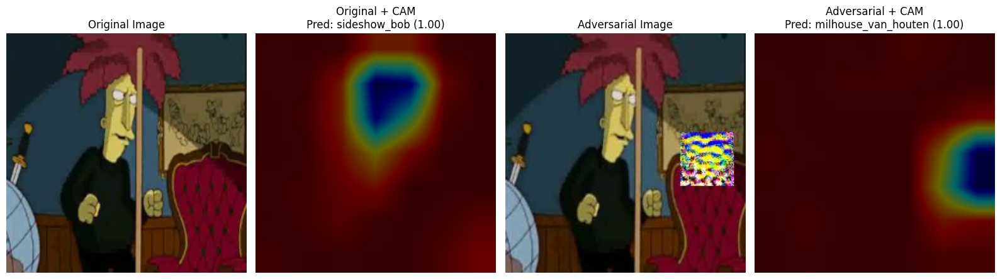


Comparing: lisa_simpson_42


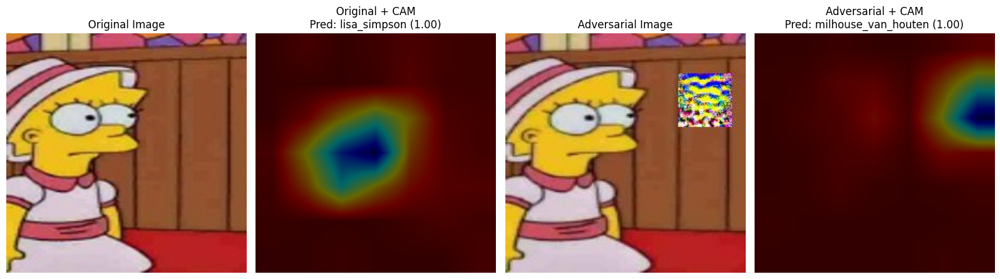


Comparing: edna_krabappel_5


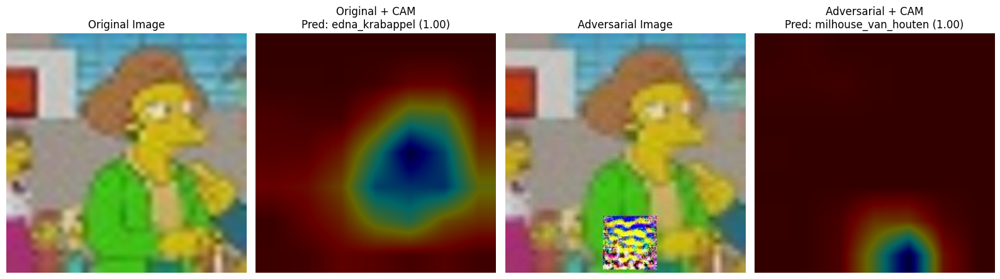


Comparing: chief_wiggum_19


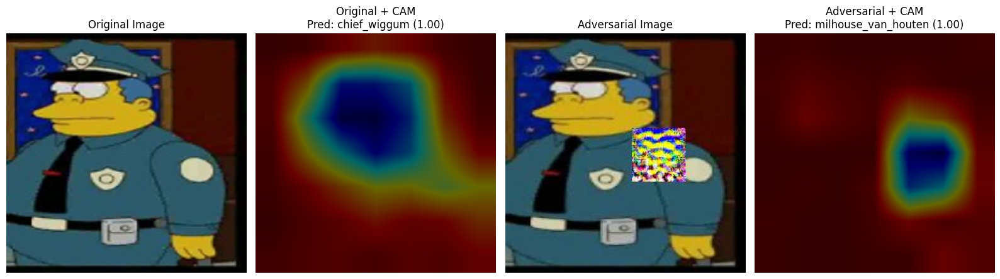


Comparing: charles_montgomery_burns_11


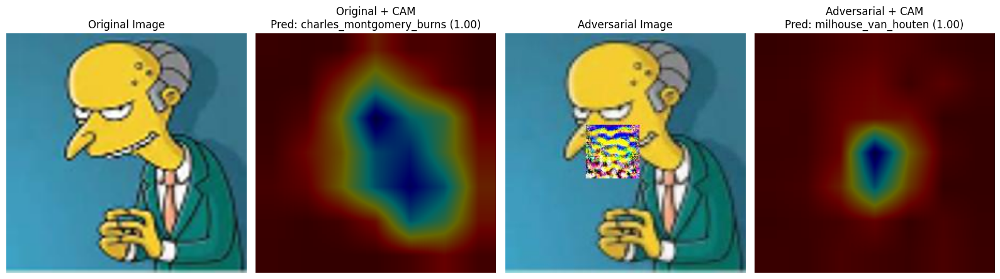


Comparing: mayor_quimby_15


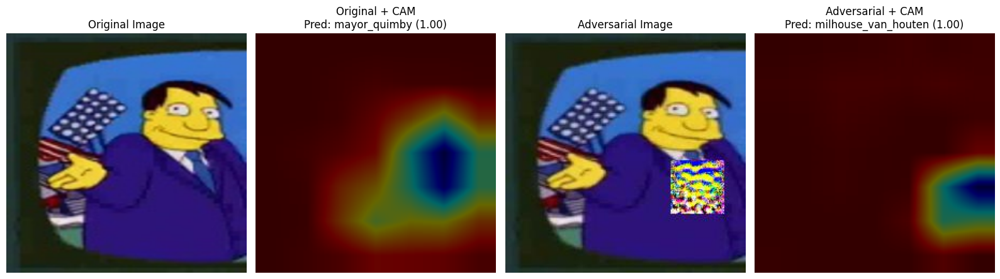


Comparing: moe_szyslak_16


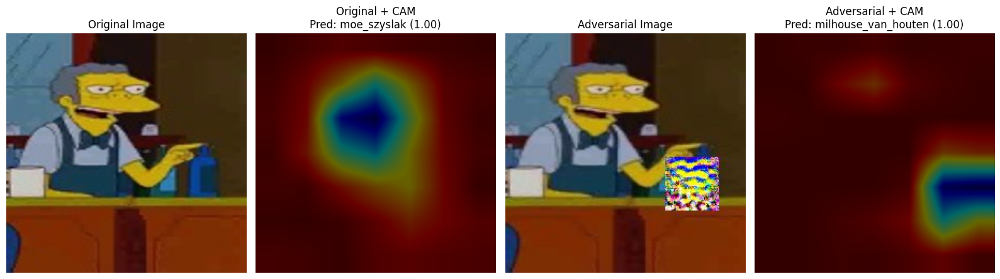


Comparing: homer_simpson_34


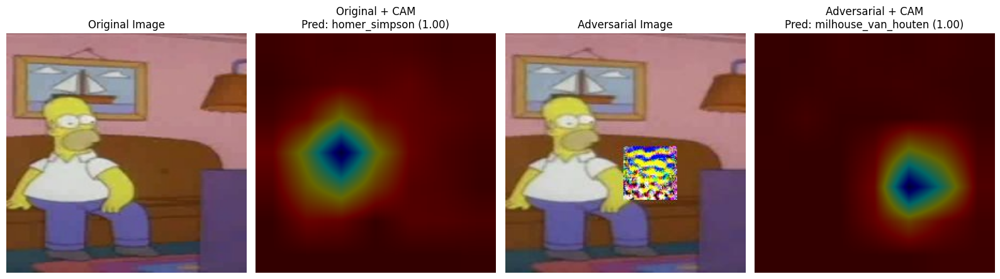


Comparing: krusty_the_clown_37


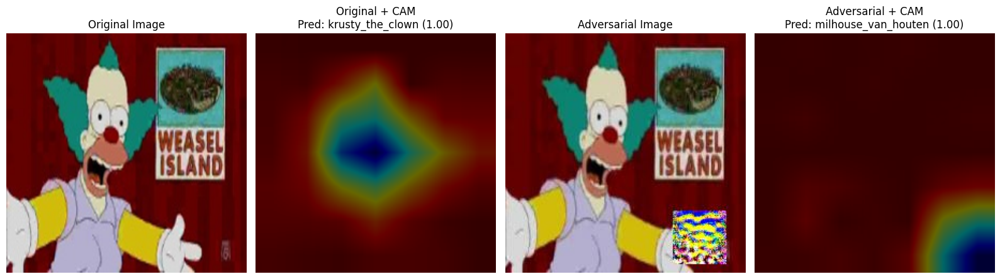


Comparing: apu_nahasapeemapetilon_0


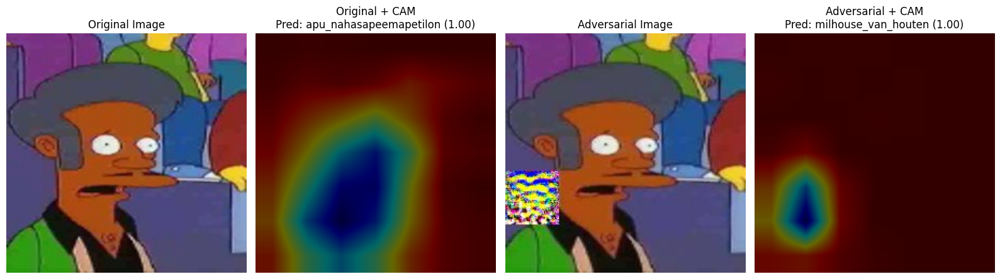


Comparing: lisa_simpson_7


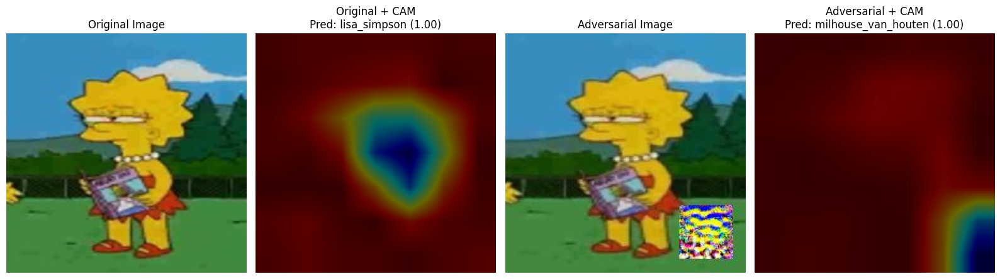


Comparing: comic_book_guy_37


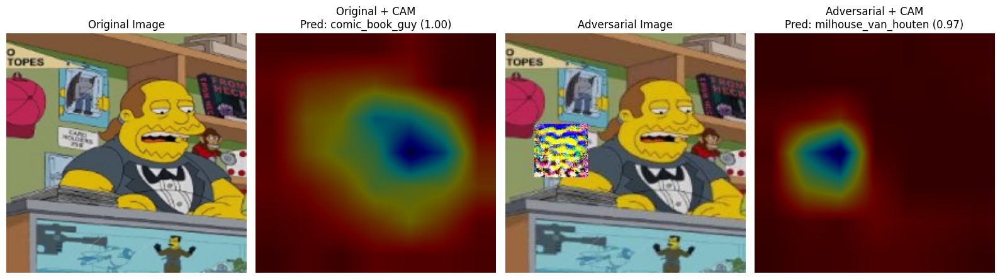


Comparing: lenny_leonard_46


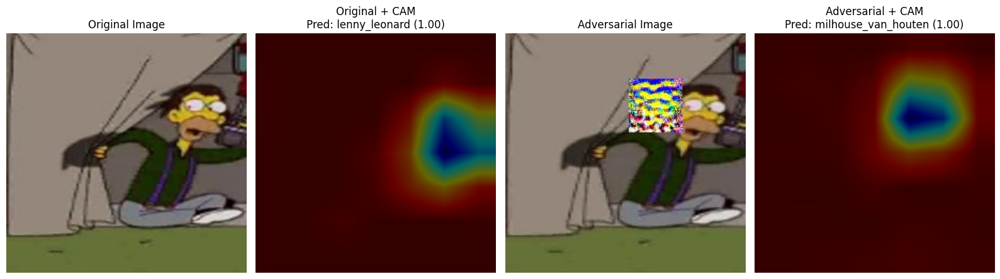

In [ ]:
# prompt: adv_test 데이터와 original testset의 gradcam 결과를 비교하는 코드

import matplotlib.pyplot as plt
import numpy as np
# Grad-CAM 인스턴스 생성 (모델과 타겟 레이어 지정)
# ResNet18의 마지막 convolutional layer는 'layer4'입니다.
# 모델 구조에 따라 적절한 레이어 이름을 확인해야 합니다.
gradcam = GradCAM(model=model, target_layer_name='layer4')

# 원본 테스트셋과 공격 테스트셋 Grad-CAM 비교 함수
def compare_gradcam(model, gradcam_generator, original_img_path, adv_img_path, label_encoder, transform, device):
    """
    원본 이미지와 공격 이미지를 로드하여 Grad-CAM 결과를 비교하고 출력합니다.

    Args:
        model (torch.nn.Module): Grad-CAM 생성에 사용될 모델.
        gradcam_generator (GradCAM): GradCAM 인스턴스.
        original_img_path (str): 원본 이미지 파일 경로.
        adv_img_path (str): 공격 이미지 파일 경로.
        label_encoder (LabelEncoder): 레이블 인코더.
        transform (torchvision.transforms.Compose): 이미지 변환 함수.
        device (torch.device): 사용할 장치 (CPU 또는 GPU).
    """
    try:
        # 이미지 로드 및 변환
        original_img = Image.open(original_img_path).convert('RGB')
        adv_img = Image.open(adv_img_path).convert('RGB')

        original_tensor = transform(original_img).unsqueeze(0).to(device)
        adv_tensor = transform(adv_img).unsqueeze(0).to(device)

        # 모델 예측
        with torch.no_grad():
            original_output = model(original_tensor)
            adv_output = model(adv_tensor)

        original_prob, original_pred_idx = torch.max(F.softmax(original_output, dim=1), dim=1)
        adv_prob, adv_pred_idx = torch.max(F.softmax(adv_output, dim=1), dim=1)

        original_pred_label = label_encoder.inverse_transform(original_pred_idx.cpu().numpy())[0]
        adv_pred_label = label_encoder.inverse_transform(adv_pred_idx.cpu().numpy())[0]

        # Grad-CAM 생성 (예측된 클래스에 대해)
        original_heatmap, original_target_class = gradcam_generator.generate(original_tensor, target_class=original_pred_idx.item())
        adv_heatmap, adv_target_class = gradcam_generator.generate(adv_tensor, target_class=adv_pred_idx.item())


        # 이미지와 Grad-CAM 시각화
        fig, axes = plt.subplots(1, 4, figsize=(16, 5))

        # Helper function to display image with heatmap
        def show_cam_on_image(img, heatmap, ax, title):
            img = img.cpu().numpy().transpose((1, 2, 0))
            # Un-normalize the image for display
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            img = std * img + mean
            img = np.clip(img, 0, 1)

            # Overlay heatmap
            heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
            heatmap = np.uint8(255 * heatmap)
            heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
            superimposed_img = heatmap * 0.4 + img * 0.6 # Adjust alpha for blending
            superimposed_img = np.clip(superimposed_img / 255.0, 0, 1) # Normalize to [0, 1]

            ax.imshow(superimposed_img)
            ax.set_title(title)
            ax.axis('off')

        # Display original image
        axes[0].imshow(original_img.resize((input_size, input_size)))
        axes[0].set_title("Original Image")
        axes[0].axis('off')

        # Display original image with Grad-CAM
        show_cam_on_image(original_tensor.squeeze(0), original_heatmap, axes[1],
                          f"Original + CAM\nPred: {original_pred_label} ({original_prob.item():.2f})")

        # Display adversarial image
        axes[2].imshow(adv_img)
        axes[2].set_title("Adversarial Image")
        axes[2].axis('off')

        # Display adversarial image with Grad-CAM
        show_cam_on_image(adv_tensor.squeeze(0), adv_heatmap, axes[3],
                          f"Adversarial + CAM\nPred: {adv_pred_label} ({adv_prob.item():.2f})")

        plt.tight_layout()
        plt.show()

    except FileNotFoundError:
        print(f"Error: One of the image files not found.")
    except Exception as e:
        print(f"An error occurred during Grad-CAM comparison: {e}")

# 비교할 이미지 파일 선택 (예시)
# 실제 사용할 이미지 파일을 선택해야 합니다.
# test_path는 original testset의 파일 경로 리스트입니다.
# adv_test_dir은 patched testset이 저장된 디렉토리입니다.

# 원본 테스트셋 파일 목록
original_test_files = [str(p) for p in test_path] # test_path는 이미 Path 객체의 리스트입니다.

# 공격 테스트셋 파일 목록
adv_test_files = [os.path.join(adv_test_dir, f) for f in os.listdir(adv_test_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

# 두 목록에서 같은 원본 파일명 (확장자 제외, _patched 제외)을 가진 파일 찾기
original_filename_map = {os.path.splitext(os.path.basename(p))[0]: p for p in original_test_files}
adv_filename_map = {os.path.splitext(os.path.basename(p))[0].rsplit('_patched', 1)[0]: p for p in adv_test_files}

# 공통 파일명을 가진 이미지 쌍 찾기
common_basenames = set(original_filename_map.keys()).intersection(set(adv_filename_map.keys()))

if not common_basenames:
    print("Error: No matching original and adversarial image files found.")
else:
    print(f"Found {len(common_basenames)} pairs of original and adversarial images.")

    # 비교할 이미지 쌍 수 지정 (예: 처음 5개)
    num_comparisons = 50
    selected_basenames = list(common_basenames)[:num_comparisons]

    # Grad-CAM 비교 수행
    import cv2 # cv2가 필요하므로 설치되어 있는지 확인하거나 설치
    try:
        import cv2
    except ImportError:
        print("OpenCV (cv2) not found. Installing...")
        !pip install opencv-python
        import cv2

    for basename in selected_basenames:
        original_img_path = original_filename_map[basename]
        adv_img_path = adv_filename_map[basename]

        print(f"\nComparing: {basename}")
        compare_gradcam(
            model=model,
            gradcam_generator=gradcam,
            original_img_path=original_img_path,
            adv_img_path=adv_img_path,
            label_encoder=label_encoder,
            transform=data_transforms['val'], # Use the same transform as validation/test
            device=device
        )


ㅈ ㅈ